In [1]:
from keras.models import load_model
from LayoutComposer import LayoutComposer
import os
layoutcomposer = LayoutComposer(F=8)
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID" # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"] = "" 
model = layoutcomposer.createModel()
model.load_weights('LayoutCheckpoints/weights-improvement-03-383.14.hdf5')

Using TensorFlow backend.


__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Vi_1 (InputLayer)               (None, 128, 128, 24) 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 64, 64, 64)   13888       Vi_1[0][0]                       
__________________________________________________________________________________________________
leaky_re_lu_1 (LeakyReLU)       (None, 64, 64, 64)   0           conv2d_1[0][0]                   
__________________________________________________________________________________________________
input_1 (InputLayer)            (None, 75)           0                                            
__________________________________________________________________________________________________
batch_norm

In [2]:
import numpy as np
import glob
import matplotlib.pyplot as plt
%matplotlib inline
import json
from loaddata import*

with open('lstminput.json') as f:
        lstminput = json.load(f)
with open('layoutannotations.json') as f:
                        annotations = json.load(f)
global_ID = 's_03_e_16_shot_026202_026276'
anno = annotations[global_ID]
annos = []
for obj in anno['objects']:
    annos.append(obj)
for char in anno['characters']:
    annos.append(char)
print(annos)
Entities = []
Embeddings = []
Trackings = []
gridCoordinate = []
EntityPos = []
video = np.load('Dataset/flintstones_dataset/video_frames/'+global_ID+'.npy')
file_names = glob.glob('Dataset/flintstones_dataset/layoutcomposer_in/'+global_ID+'*')
grid = np.empty((32, 32, 2))
for i in range(32):
    for j in range(32):
        grid[i][j][1] = i
        grid[i][j][0] = j
counter = 0
for ann in annos:
    print(ann['globalID'])
    data_point = np.load('Dataset/flintstones_dataset/layoutcomposer_in/'+ann['globalID']+'.npz')
    Entities.append(data_point['Vi'][:,:,np.array([0,1,2,15,16,17,30,31,32,72,73,74,120,121,122,162,163,164,183,184,185,210,211,212])])
    #Embeddings.append(data_point['embedding'])
    Embeddings.append(np.array(np.reshape(np.array(lstminput[global_ID]), (75,))))
    gridCoordinate.append(grid)
    EntityPos.append([counter, ann['entitySpan'][1] - 1])
    counter = counter + 1
file_names = glob.glob('Dataset/flintstones_dataset/entity_tracking/'+global_ID+'*')
for file_name in file_names:
    Trackings.append(np.load(file_name))
#data_point = np.load('flintstones_dataset/layoutcomposer_in/s_06_e_25_shot_033757_033831_char_0.npz')
#Entities.append(data_point['Vi'][:,:,np.array([30,31,32,120,121,122,210,211,212])])
#Embeddings.append(data_point['embedding'])
#data_point = np.load('flintstones_dataset/layoutcomposer_in/s_06_e_25_shot_033757_033831_char_1.npz')
#Entities.append(data_point['Vi'][:,:,np.array([30,31,32,120,121,122,210,211,212])])
#Embeddings.append(data_point['embedding'])
#data_point = np.load('flintstones_dataset/layoutcomposer_in/s_03_e_16_shot_028039_028113_char_0.npz')
#Entities.append(data_point['Vi'][:,:,np.array([30,31,32,120,121,122,210,211,212])])
#Embeddings.append(data_point['embedding'])
#data_point = np.load('flintstones_dataset/layoutcomposer_in/s_06_e_25_shot_016951_017025_char_0.npz')
#Entities.append(data_point['Vi'][:,:,np.array([30,31,32,120,121,122,210,211,212])])
#Embeddings.append(data_point['embedding'])

[{'labelSpan': [1, 3], 'labelNPC': 'her paper', 'entityLabel': 'paper', 'rectangles': [[106, 125, 119, 128], [], []], 'entitySpan': [15, 17], 'globalID': 's_03_e_16_shot_026202_026276_paper_1_3'}, {'labelSpan': [1, 6], 'labelNPC': 'the chair', 'entityLabel': 'chair', 'rectangles': [[58, 67, 101, 123], [68, 69, 108, 125], [58, 66, 104, 119]], 'entitySpan': [18, 20], 'globalID': 's_03_e_16_shot_026202_026276_chair_1_6'}, {'actions': ['speaks'], 'labelNPC': 'fred', 'entityLabel': 'fred', 'rectangles': [[23, 23, 55, 124], [23, 19, 59, 124], [28, 18, 55, 126]], 'entitySpan': [0, 1], 'globalID': 's_03_e_16_shot_026202_026276_char_0'}, {'actions': ['drops'], 'labelNPC': 'wilma', 'entityLabel': 'wilma', 'rectangles': [[67, 43, 94, 122], [66, 39, 96, 123], [67, 42, 94, 123]], 'entitySpan': [7, 8], 'globalID': 's_03_e_16_shot_026202_026276_char_1'}]
s_03_e_16_shot_026202_026276_paper_1_3
s_03_e_16_shot_026202_026276_chair_1_6
s_03_e_16_shot_026202_026276_char_0
s_03_e_16_shot_026202_026276_char_

(128, 128)
predicted location: (0, 0)
predicted location: (0, 0)
predicted location: (88, 116)
predicted location: (104, 28)


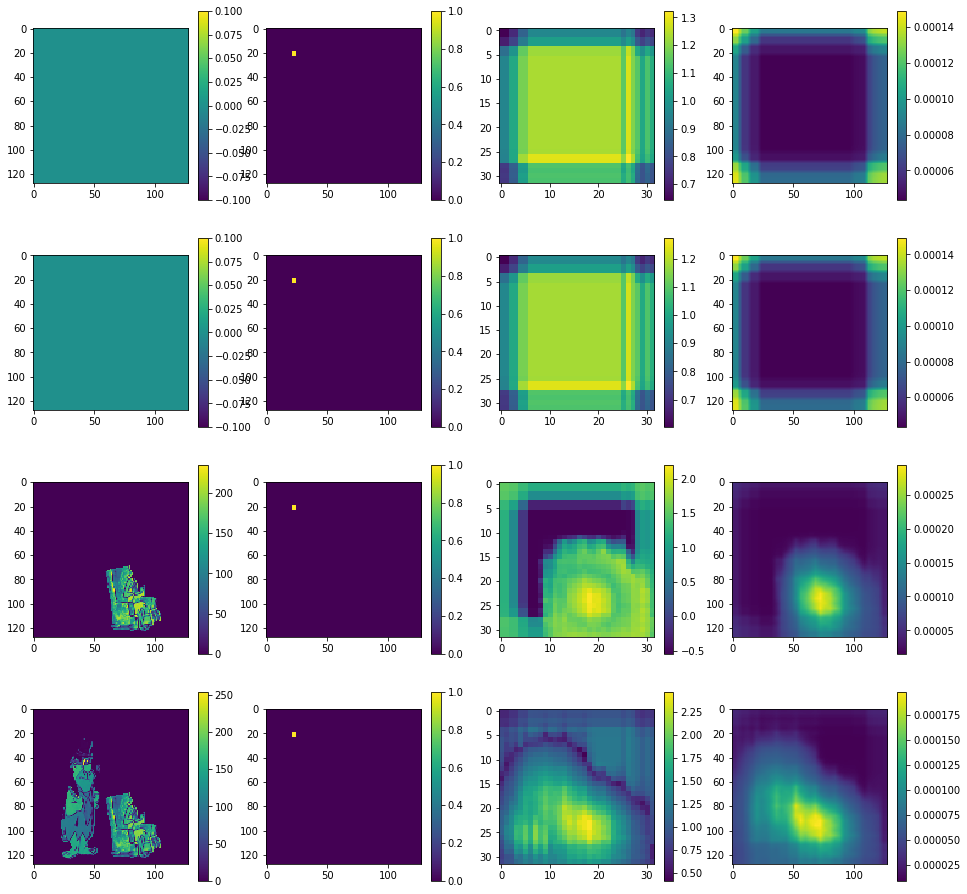

In [3]:
from keras import models
from numpy import unravel_index
nEntities = len(Entities)

layer_outputs = [layer.output for layer in model.layers[27:]] 
# Extracts the outputs of the top 12 layers
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)
activations = activation_model.predict([Entities, Embeddings, EntityPos]) 
first_layer_activation = np.reshape(activations[-1], (nEntities, 128, 128, 8))
plt.rcParams['figure.figsize'] = [16, nEntities*4]
out = np.load('Dataset/flintstones_dataset/layoutcomposer_gtF8/'+global_ID+'_char_0'+'.npz')['Ploc'][:,:,0]
print(out.shape)
fig, axes = plt.subplots(nEntities, 4)
for i in range(nEntities):
    pos = axes[i,0].imshow(Entities[i][:,:,4])
    fig.colorbar(pos, ax=axes[i,0])
    pos = axes[i,1].imshow(out, cmap='viridis')
    fig.colorbar(pos, ax=axes[i,1])
    pos = axes[i,2].imshow(activations[-10][i, :, :, 4], cmap='viridis')
    fig.colorbar(pos, ax=axes[i,2])
    pos = axes[i,3].imshow(np.reshape(activations[-1], (nEntities,128, 128, 8))[i, :, :, 4])
    fig.colorbar(pos, ax=axes[i,3])
#     plt.show()
    print("predicted location:", unravel_index(first_layer_activation[i,:,:,0].argmax(), first_layer_activation[i,:,:,0].shape))

In [4]:
prediction = model.predict([Entities, Embeddings, EntityPos])
mus = prediction[0]
Plocs = np.reshape(prediction[1], (nEntities, 128, 128, 8))
#print(np.sum(Plocs[1][:,:,7]))

0 0
0 0 0 128


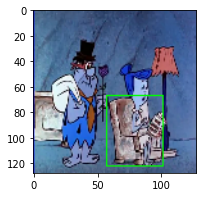

0 0
0 0 0 128


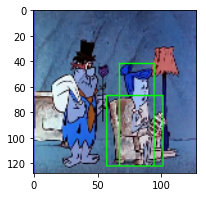

88 116
88 116 88 244


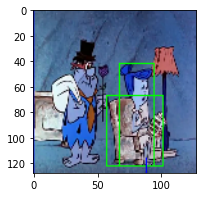

104 28
104 28 104 156


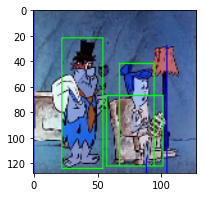

0 0
0 0 0 128


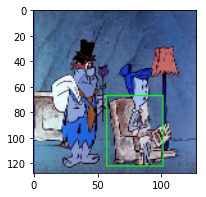

0 0
0 0 0 128


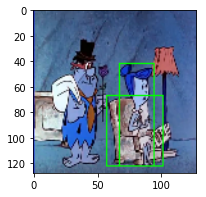

88 116
88 116 88 244


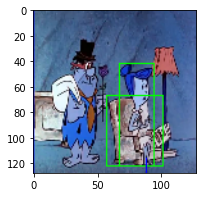

104 28
104 28 104 156


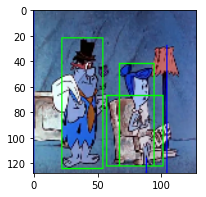

0 0
0 0 0 128


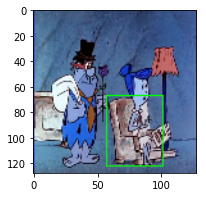

0 0
0 0 0 128


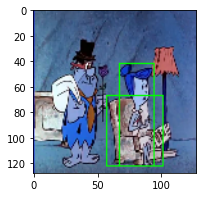

88 116
88 116 88 244


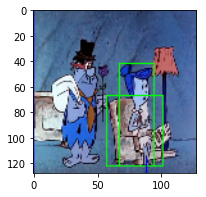

104 28
104 28 104 156


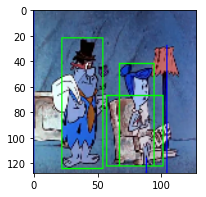

0 0
0 0 0 128


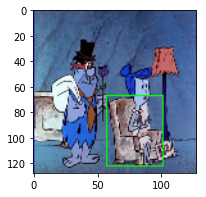

0 0
0 0 0 128


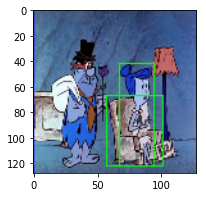

88 116
88 116 88 244


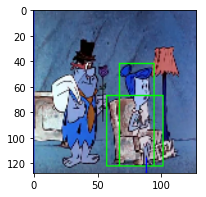

104 28
104 28 104 156


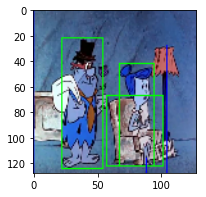

0 0
0 0 0 128


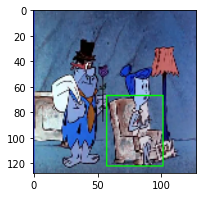

0 0
0 0 0 128


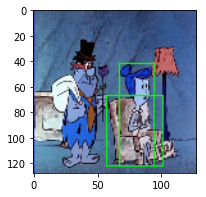

88 116
88 116 88 244


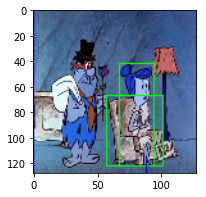

104 28
104 28 104 156


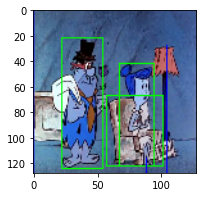

0 0
0 0 0 128


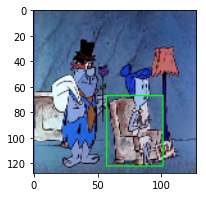

0 0
0 0 0 128


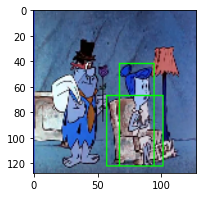

88 116
88 116 88 244


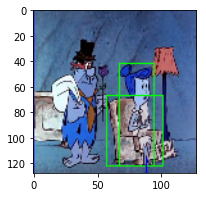

104 28
104 28 104 156


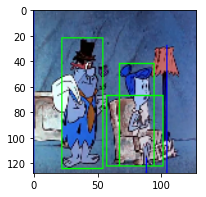

0 0
0 0 0 128


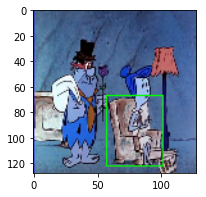

0 0
0 0 0 128


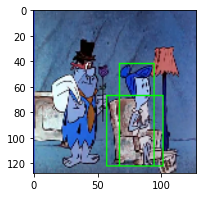

88 116
88 116 88 244


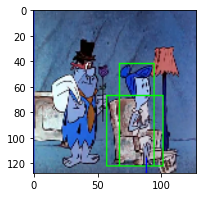

104 28
104 28 104 156


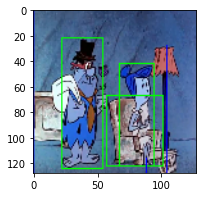

0 0
0 0 0 128


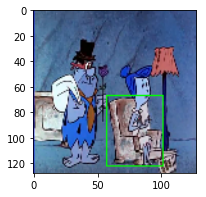

0 0
0 0 0 128


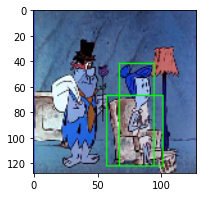

88 116
88 116 88 244


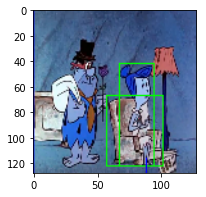

104 28
104 28 104 156


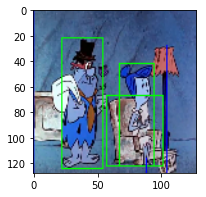

0 0
0 0 0 128


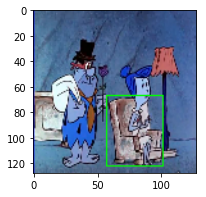

0 0
0 0 0 128


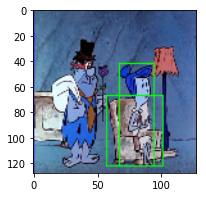

88 116
88 116 88 244


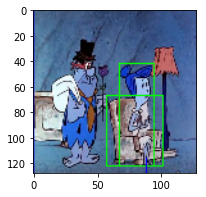

104 28
104 28 104 156


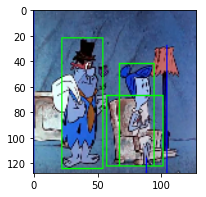

0 0
0 0 0 128


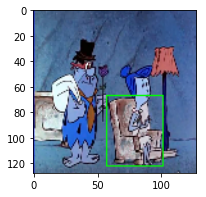

0 0
0 0 0 128


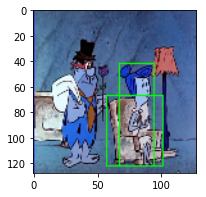

88 116
88 116 88 244


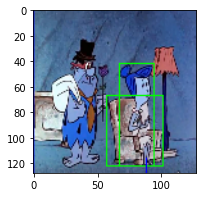

104 28
104 28 104 156


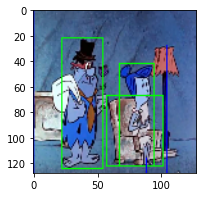

104 104
104 104 104 232


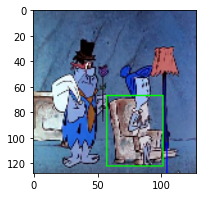

104 104
104 104 104 232


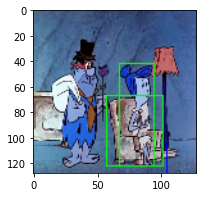

76 40
76 40 76 168


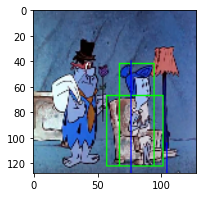

44 80
44 80 44 208


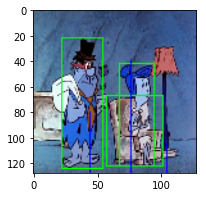

104 104
104 104 232 232


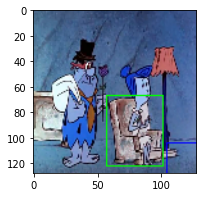

104 104
104 104 232 232


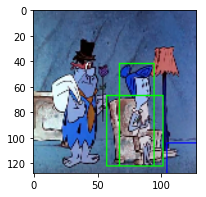

76 40
76 40 204 168


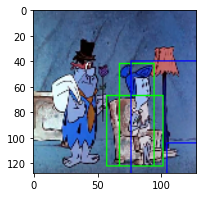

44 80
44 80 172 208


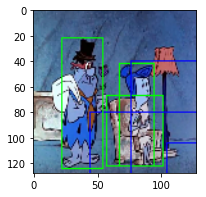

104 104
104 104 232 232


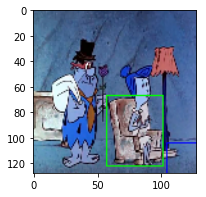

104 104
104 104 232 232


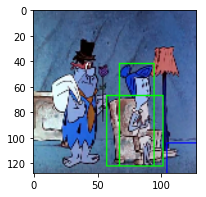

76 40
76 40 204 168


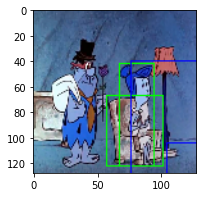

44 80
44 80 172 208


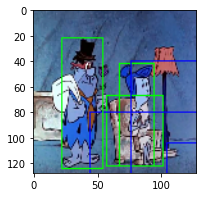

104 104
104 104 232 232


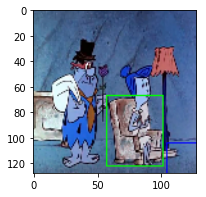

104 104
104 104 232 232


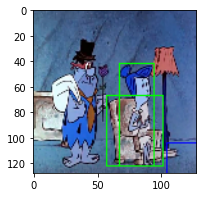

76 40
76 40 204 168


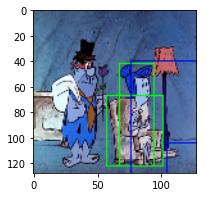

44 80
44 80 172 208


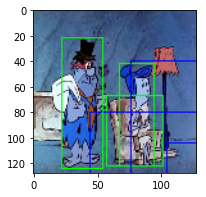

104 104
104 104 232 232


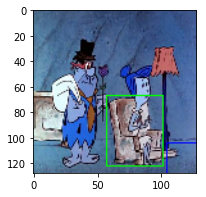

104 104
104 104 232 232


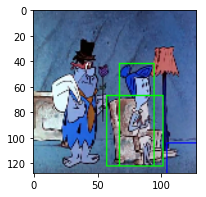

76 40
76 40 204 168


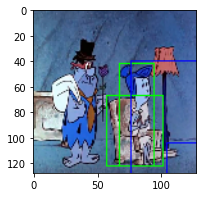

44 80
44 80 172 208


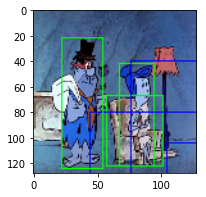

104 104
104 104 232 232


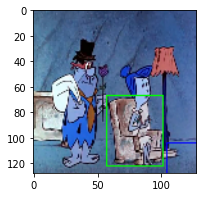

104 104
104 104 232 232


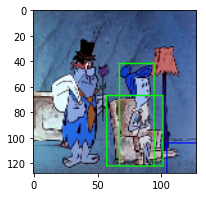

76 40
76 40 204 168


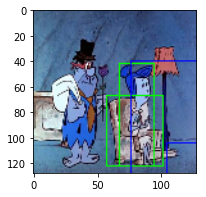

44 80
44 80 172 208


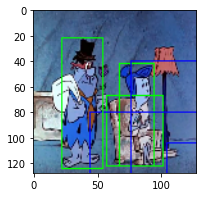

104 104
104 104 232 232


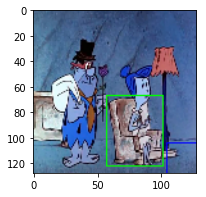

104 104
104 104 232 232


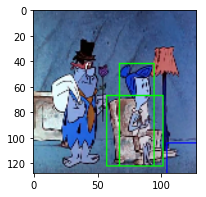

76 40
76 40 204 168


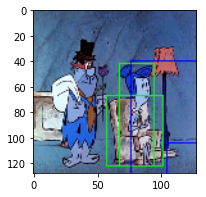

44 80
44 80 172 208


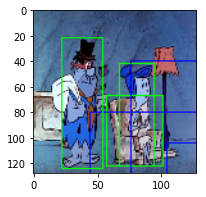

104 104
104 104 232 232


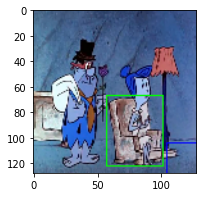

104 104
104 104 232 232


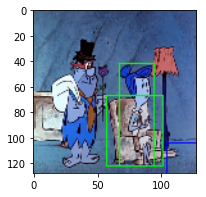

76 40
76 40 204 168


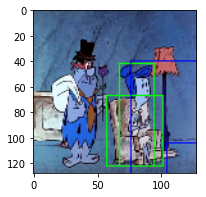

44 80
44 80 172 208


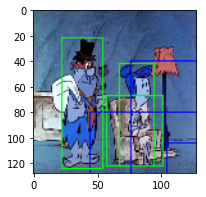

104 104
104 104 232 232


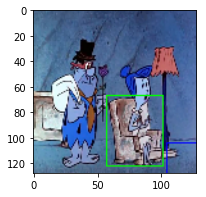

104 104
104 104 232 232


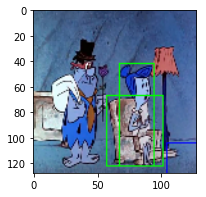

76 40
76 40 204 168


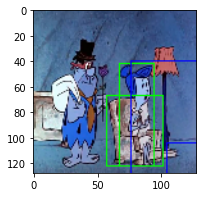

44 80
44 80 172 208


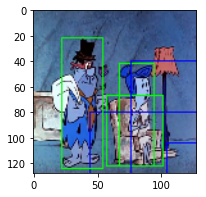

104 104
104 104 232 232


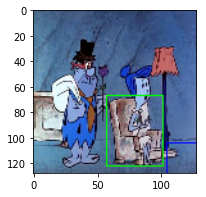

104 104
104 104 232 232


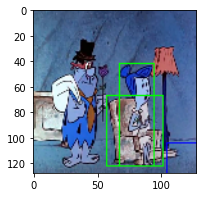

76 40
76 40 204 168


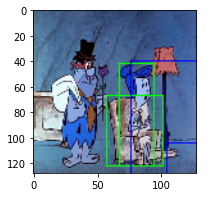

44 80
44 80 172 208


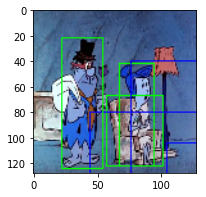

0 0
0 0 128 128


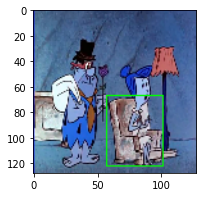

0 0
0 0 128 128


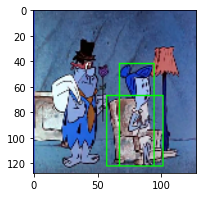

92 72
92 72 220 200


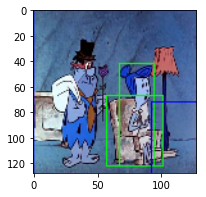

92 72
92 72 220 200


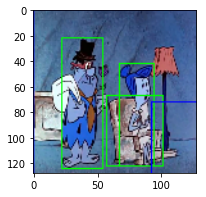

0 0
0 0 0 128


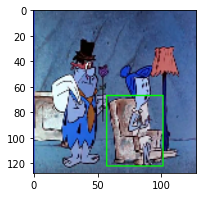

0 0
0 0 0 128


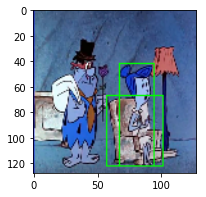

92 72
92 72 92 200


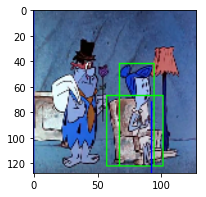

92 72
92 72 92 200


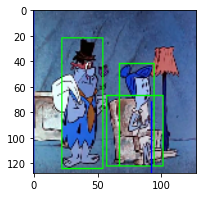

0 0
0 0 0 128


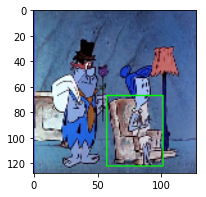

0 0
0 0 0 128


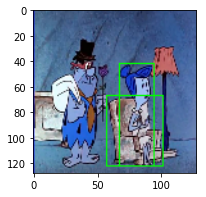

92 72
92 72 92 200


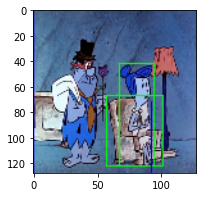

92 72
92 72 92 200


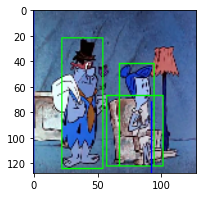

0 0
0 0 0 128


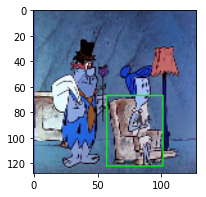

0 0
0 0 0 128


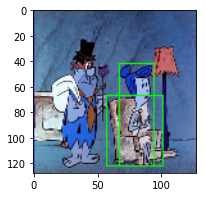

92 72
92 72 92 200


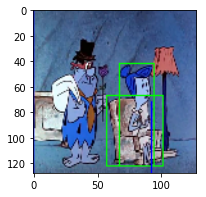

92 72
92 72 92 200


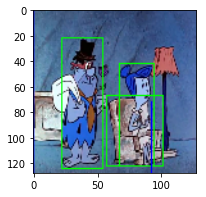

0 0
0 0 0 128


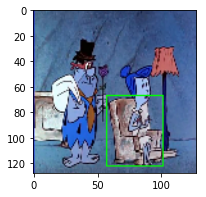

0 0
0 0 0 128


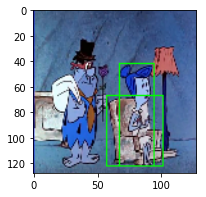

92 72
92 72 92 200


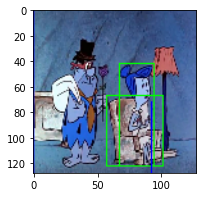

92 72
92 72 92 200


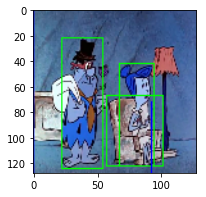

0 0
0 0 0 128


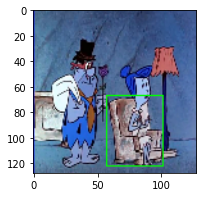

0 0
0 0 0 128


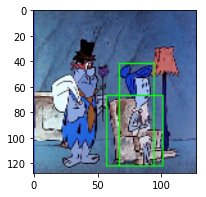

92 72
92 72 92 200


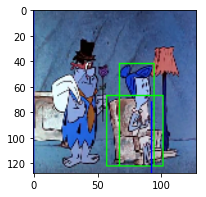

92 72
92 72 92 200


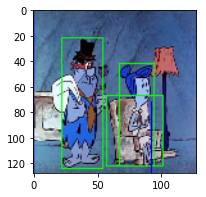

0 0
0 0 0 128


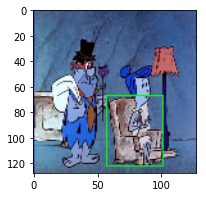

0 0
0 0 0 128


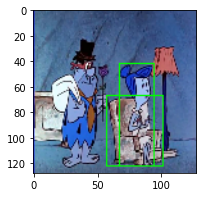

92 72
92 72 92 200


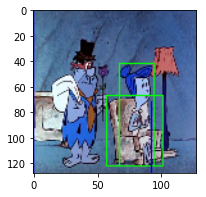

92 72
92 72 92 200


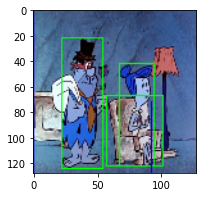

0 0
0 0 0 128


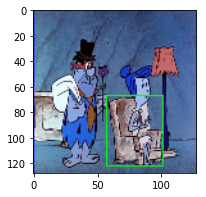

0 0
0 0 0 128


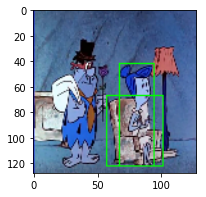

92 72
92 72 92 200


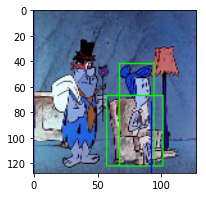

92 72
92 72 92 200


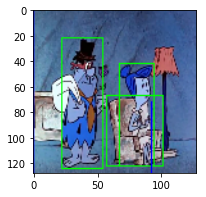

0 0
0 0 0 128


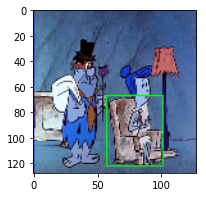

0 0
0 0 0 128


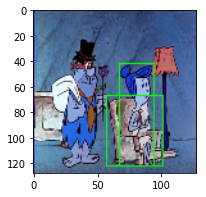

92 72
92 72 92 200


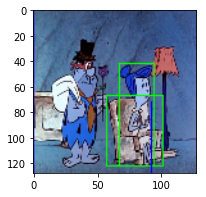

92 72
92 72 92 200


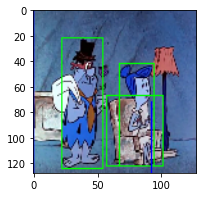

0 0
0 0 0 128


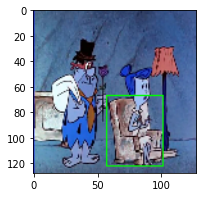

0 0
0 0 0 128


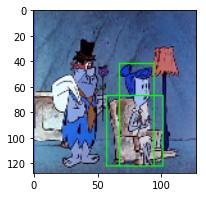

92 72
92 72 92 200


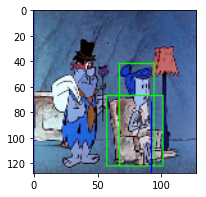

92 72
92 72 92 200


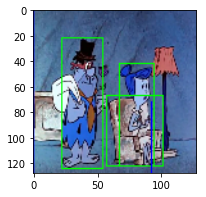

124 0
124 0 124 128


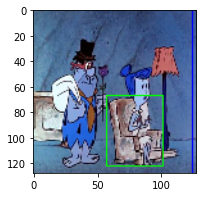

124 0
124 0 124 128


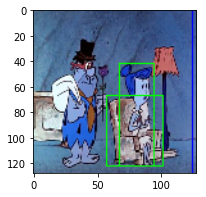

96 72
96 72 96 200


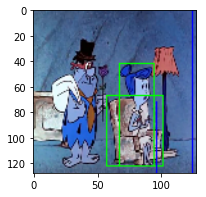

92 72
92 72 92 200


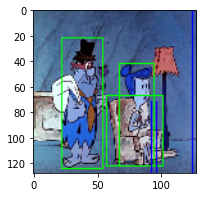

124 0
124 0 124 0


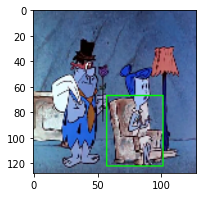

124 0
124 0 124 0


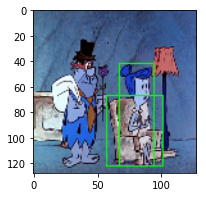

96 72
96 72 96 200


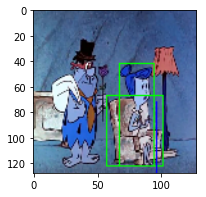

92 72
92 72 92 200


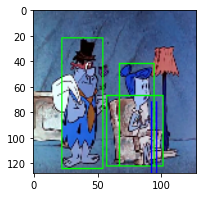

124 0
124 0 124 0


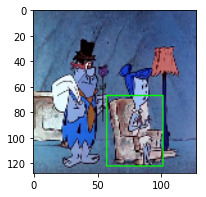

124 0
124 0 124 0


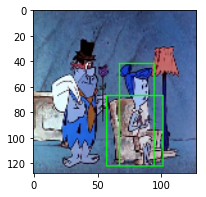

96 72
96 72 96 200


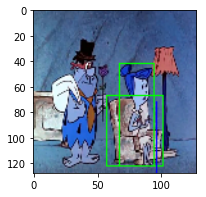

92 72
92 72 92 200


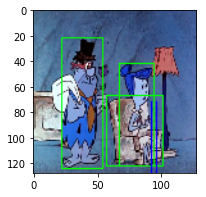

124 0
124 0 124 0


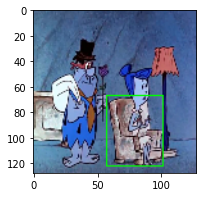

124 0
124 0 124 0


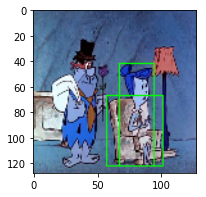

96 72
96 72 96 200


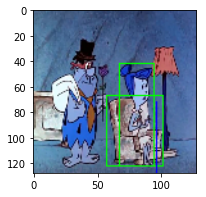

92 72
92 72 92 200


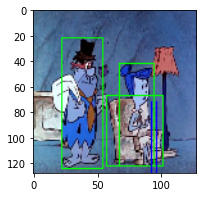

124 0
124 0 124 0


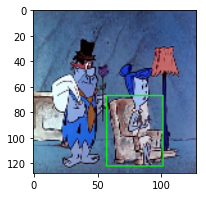

124 0
124 0 124 0


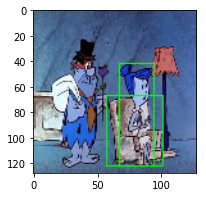

96 72
96 72 96 200


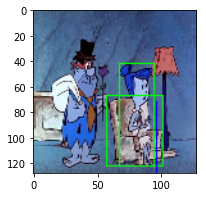

92 72
92 72 92 200


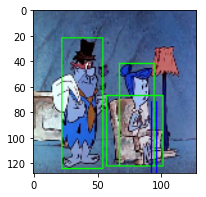

124 0
124 0 124 0


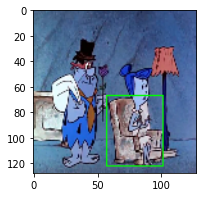

124 0
124 0 124 0


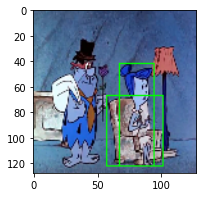

96 72
96 72 96 200


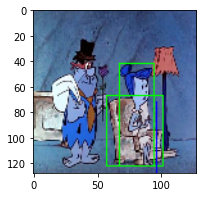

92 72
92 72 92 200


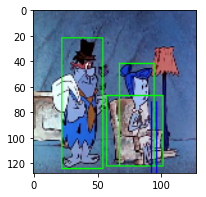

124 0
124 0 124 0


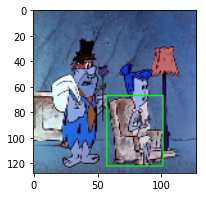

124 0
124 0 124 0


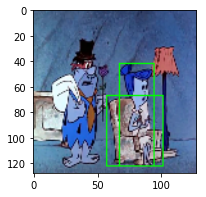

96 72
96 72 96 200


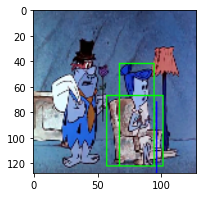

92 72
92 72 92 200


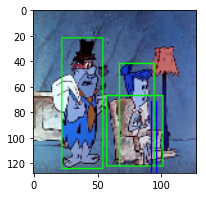

124 0
124 0 124 0


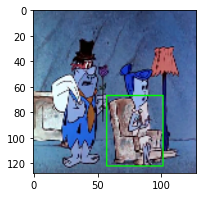

124 0
124 0 124 0


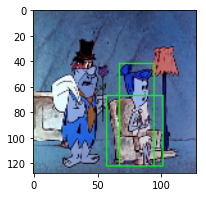

96 72
96 72 96 200


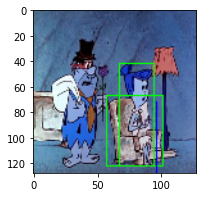

92 72
92 72 92 200


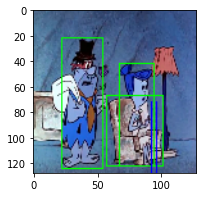

124 0
124 0 124 0


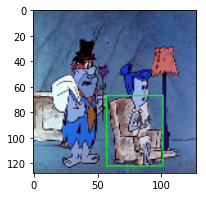

124 0
124 0 124 0


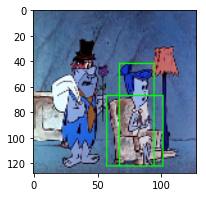

96 72
96 72 96 200


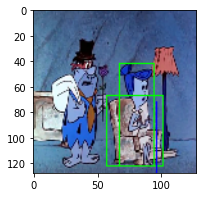

92 72
92 72 92 200


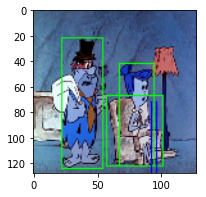

124 0
124 0 124 0


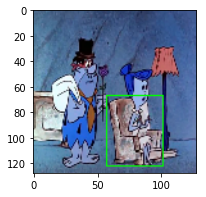

124 0
124 0 124 0


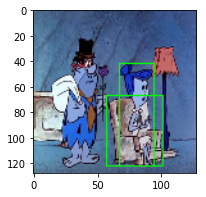

96 72
96 72 96 200


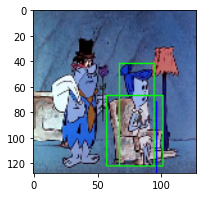

92 72
92 72 92 200


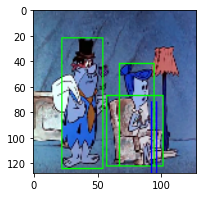

0 0
0 0 0 0


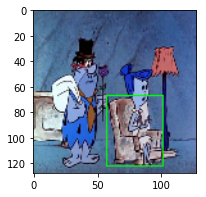

0 0
0 0 0 0


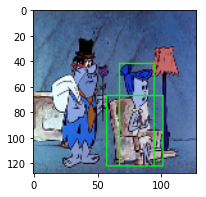

96 72
96 72 96 200


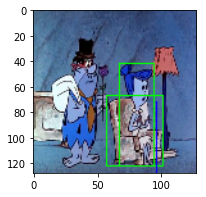

92 72
92 72 92 200


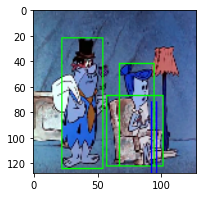

0 0
0 0 0 128


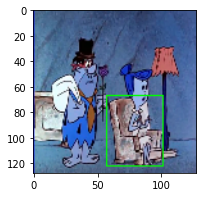

0 0
0 0 0 128


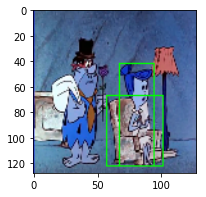

96 72
96 72 96 200


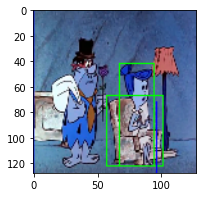

92 72
92 72 92 200


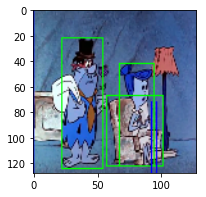

0 0
0 0 0 128


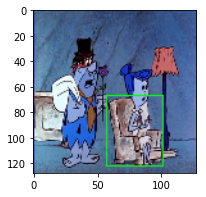

0 0
0 0 0 128


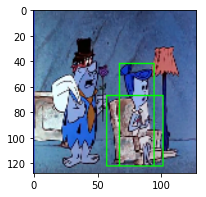

96 72
96 72 96 200


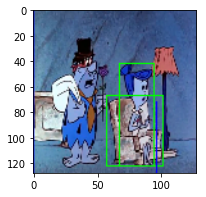

92 72
92 72 92 200


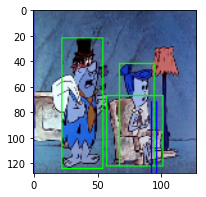

0 0
0 0 0 128


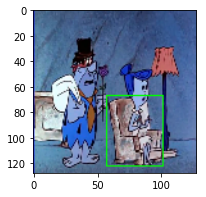

0 0
0 0 0 128


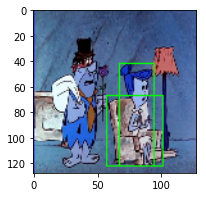

96 72
96 72 96 200


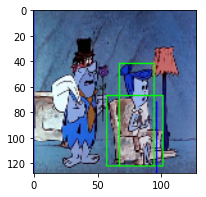

92 72
92 72 92 200


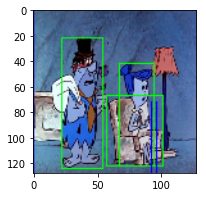

0 0
0 0 0 128


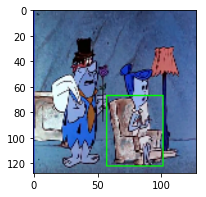

0 0
0 0 0 128


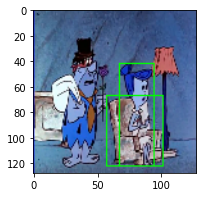

96 72
96 72 96 200


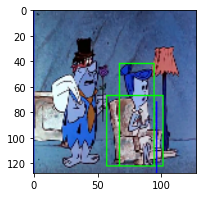

92 72
92 72 92 200


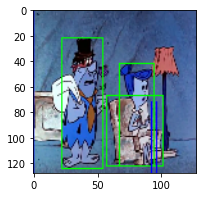

0 0
0 0 0 128


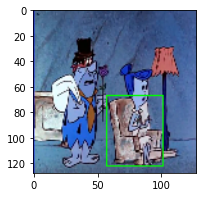

0 0
0 0 0 128


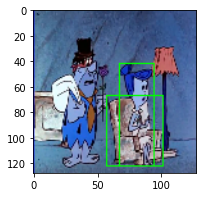

96 72
96 72 96 200


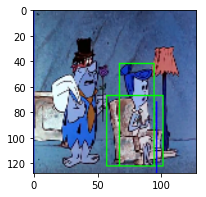

92 72
92 72 92 200


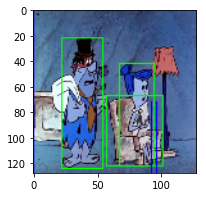

0 0
0 0 0 128


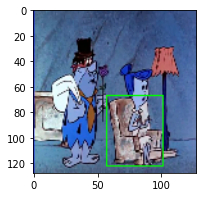

0 0
0 0 0 128


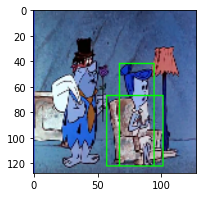

96 72
96 72 96 200


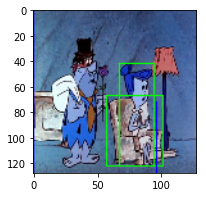

92 72
92 72 92 200


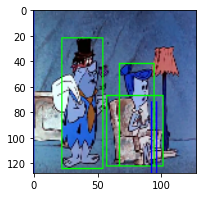

0 0
0 0 0 128


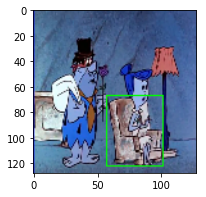

0 0
0 0 0 128


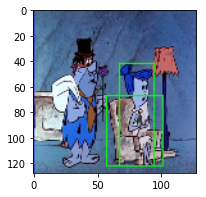

96 72
96 72 96 200


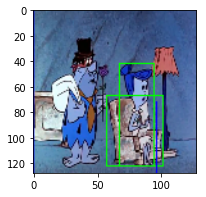

92 72
92 72 92 200


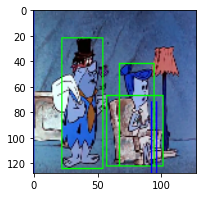

0 0
0 0 0 128


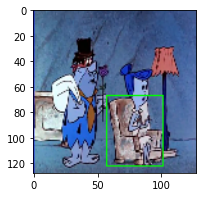

0 0
0 0 0 128


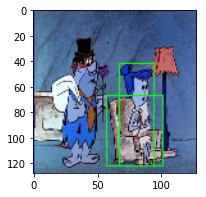

96 72
96 72 96 200


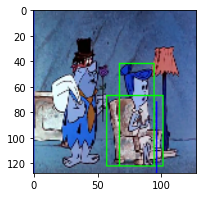

92 72
92 72 92 200


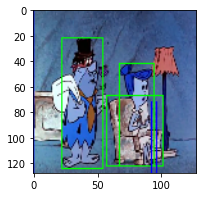

0 0
0 0 0 128


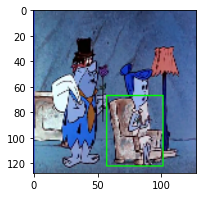

0 0
0 0 0 128


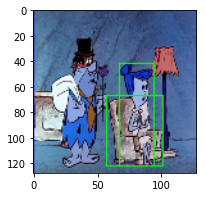

96 72
96 72 96 200


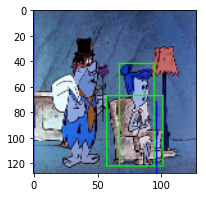

92 72
92 72 92 200


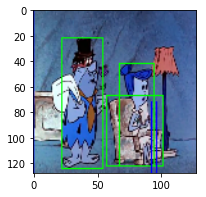

0 0
0 0 0 128


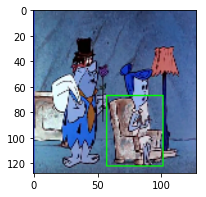

0 0
0 0 0 128


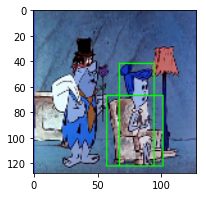

96 72
96 72 96 200


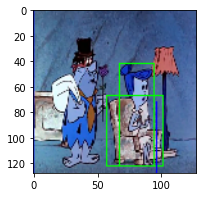

96 72
96 72 96 200


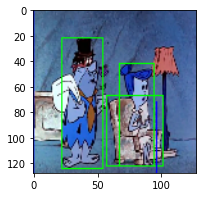

0 0
0 0 0 128


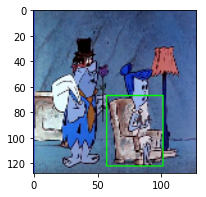

0 0
0 0 0 128


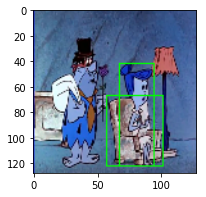

96 72
96 72 96 200


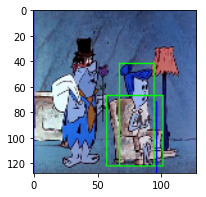

96 72
96 72 96 200


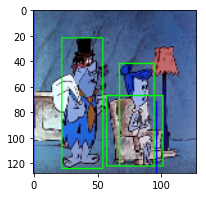

0 0
0 0 0 128


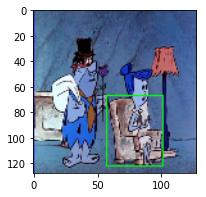

0 0
0 0 0 128


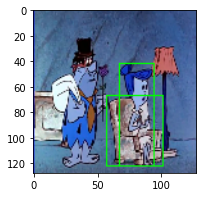

96 72
96 72 96 200


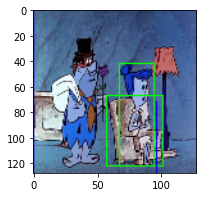

96 72
96 72 96 200


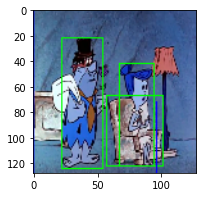

0 0
0 0 0 128


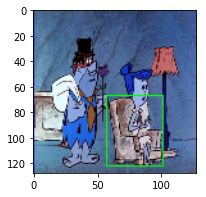

0 0
0 0 0 128


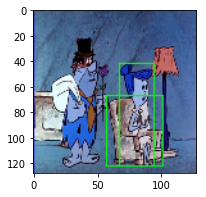

96 72
96 72 96 200


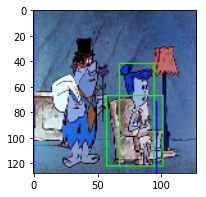

96 72
96 72 96 200


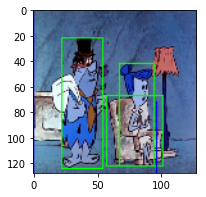

0 0
0 0 0 128


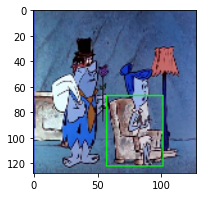

0 0
0 0 0 128


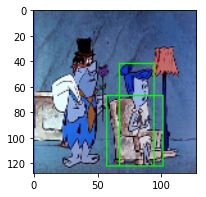

96 72
96 72 96 200


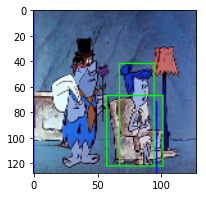

96 72
96 72 96 200


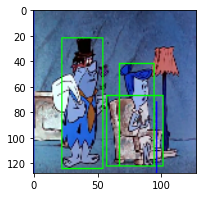

0 0
0 0 0 128


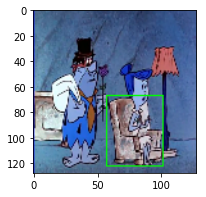

0 0
0 0 0 128


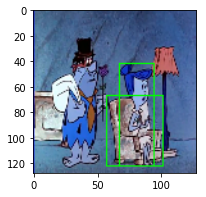

96 72
96 72 96 200


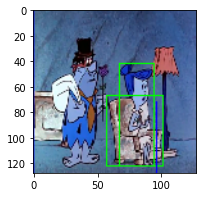

96 72
96 72 96 200


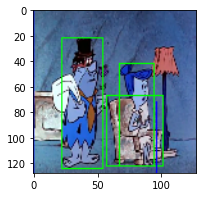

0 0
0 0 0 128


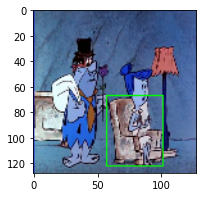

0 0
0 0 0 128


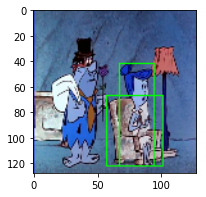

96 72
96 72 96 200


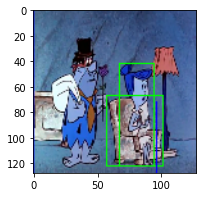

96 72
96 72 96 200


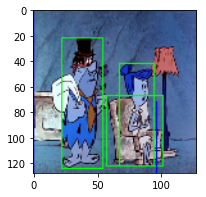

0 0
0 0 0 128


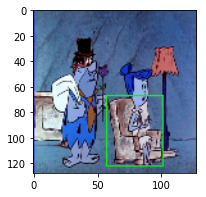

0 0
0 0 0 128


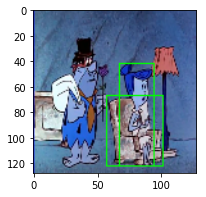

96 72
96 72 96 200


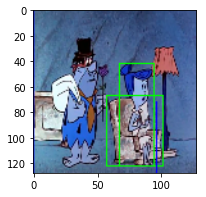

96 72
96 72 96 200


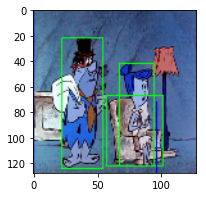

0 0
0 0 0 128


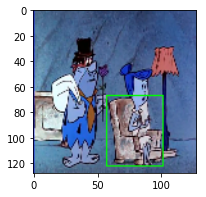

0 0
0 0 0 128


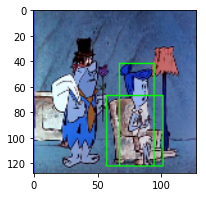

96 72
96 72 96 200


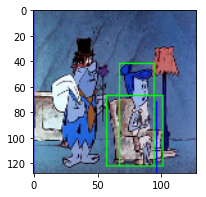

96 72
96 72 96 200


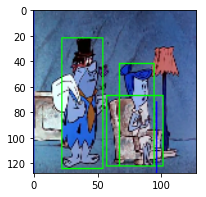

0 0
0 0 0 128


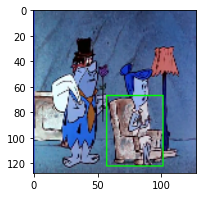

0 0
0 0 0 128


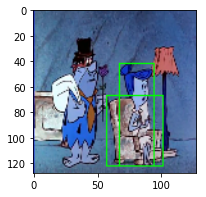

96 72
96 72 96 200


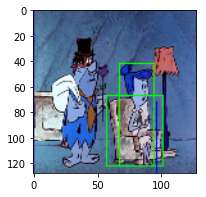

96 72
96 72 96 200


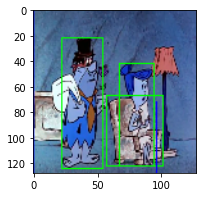

0 0
0 0 0 128


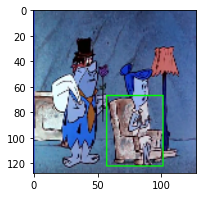

0 0
0 0 0 128


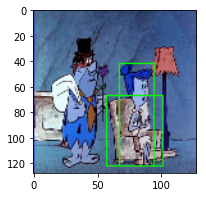

96 72
96 72 96 200


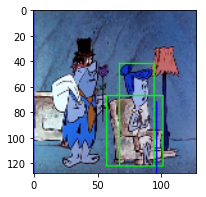

92 72
92 72 92 200


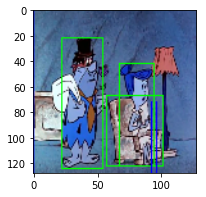

0 0
0 0 0 128


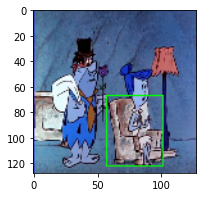

0 0
0 0 0 128


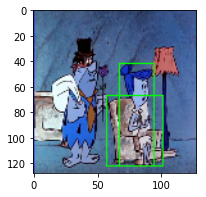

96 72
96 72 96 200


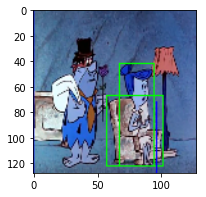

92 72
92 72 92 200


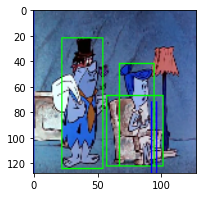

0 0
0 0 0 128


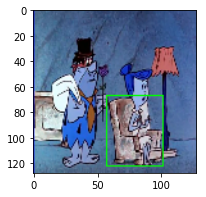

0 0
0 0 0 128


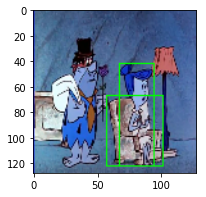

96 72
96 72 96 200


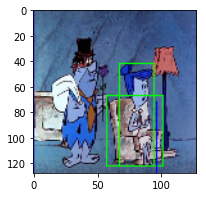

92 72
92 72 92 200


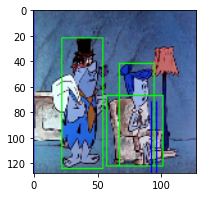

0 0
0 0 0 128


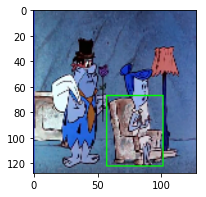

0 0
0 0 0 128


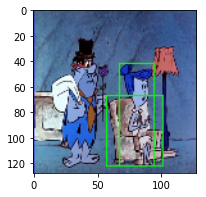

96 72
96 72 96 200


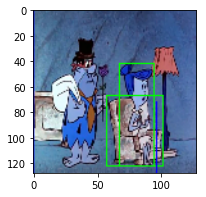

92 72
92 72 92 200


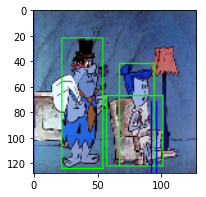

0 0
0 0 0 128


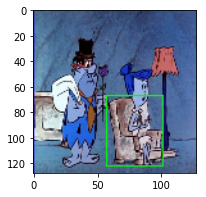

0 0
0 0 0 128


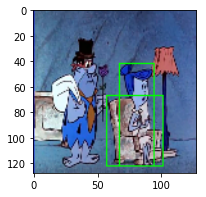

96 72
96 72 96 200


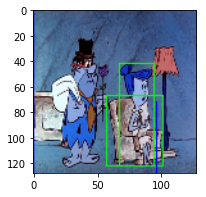

92 72
92 72 92 200


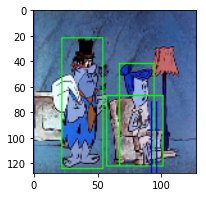

0 0
0 0 0 128


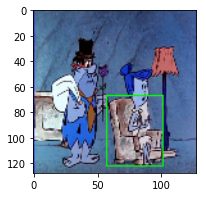

0 0
0 0 0 128


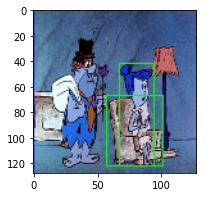

96 72
96 72 96 200


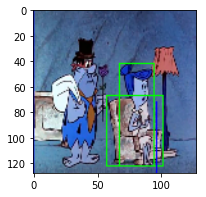

92 72
92 72 92 200


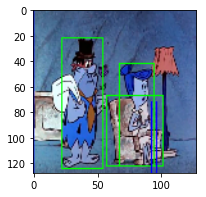

0 0
0 0 0 128


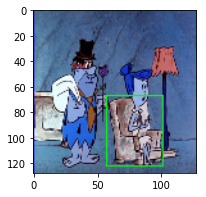

0 0
0 0 0 128


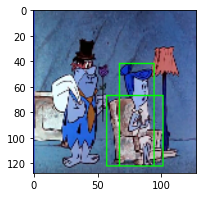

96 72
96 72 96 200


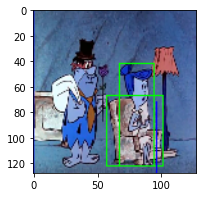

92 72
92 72 92 200


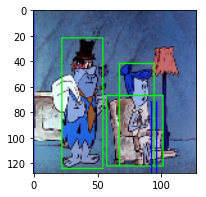

0 0
0 0 0 128


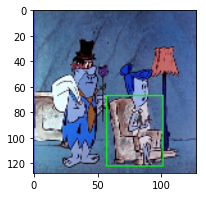

0 0
0 0 0 128


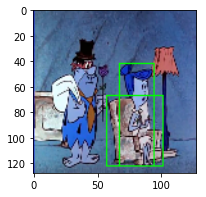

96 72
96 72 96 200


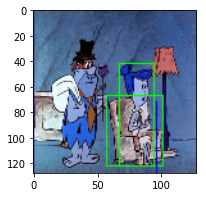

92 72
92 72 92 200


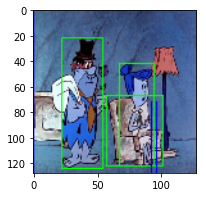

0 0
0 0 0 128


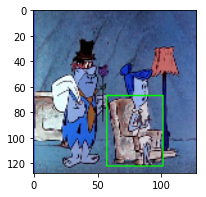

0 0
0 0 0 128


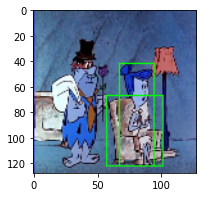

96 72
96 72 96 200


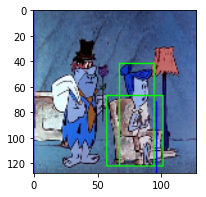

92 72
92 72 92 200


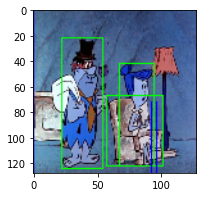

0 0
0 0 0 128


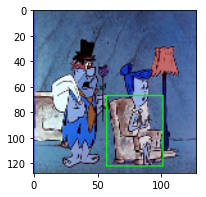

0 0
0 0 0 128


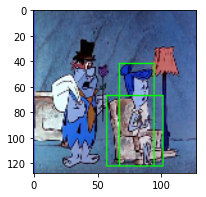

96 72
96 72 96 200


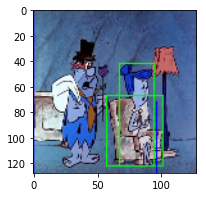

92 72
92 72 92 200


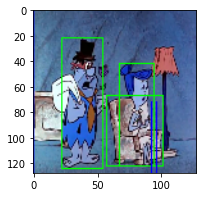

0 0
0 0 0 128


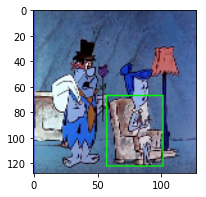

0 0
0 0 0 128


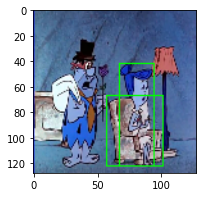

96 72
96 72 96 200


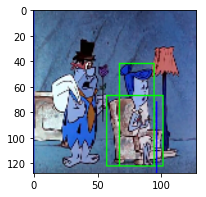

96 72
96 72 96 200


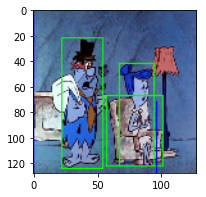

0 0
0 0 0 0


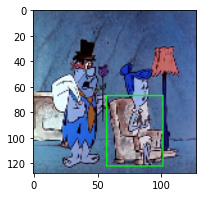

0 0
0 0 0 0


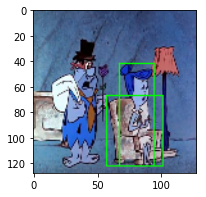

96 72
96 72 96 72


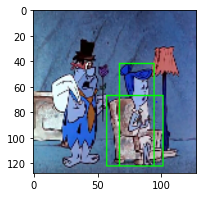

96 72
96 72 96 72


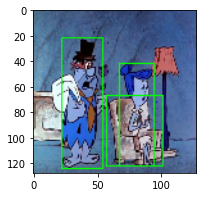

0 0
0 0 0 0


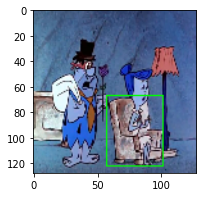

0 0
0 0 0 0


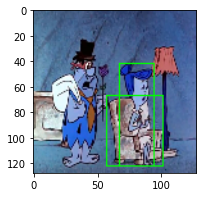

96 72
96 72 96 72


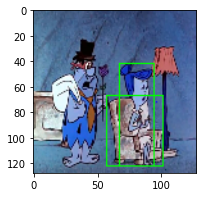

96 72
96 72 96 72


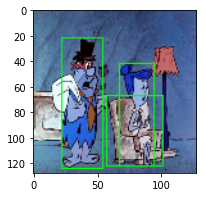

0 0
0 0 0 0


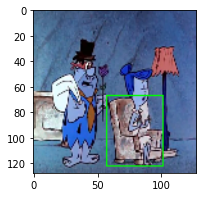

0 0
0 0 0 0


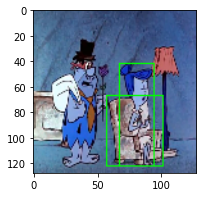

96 72
96 72 96 72


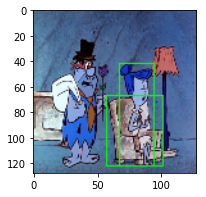

96 72
96 72 96 72


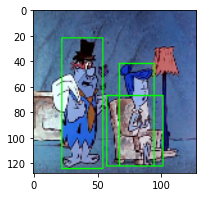

0 0
0 0 0 0


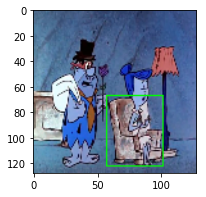

0 0
0 0 0 0


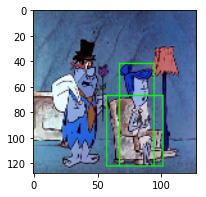

96 72
96 72 96 72


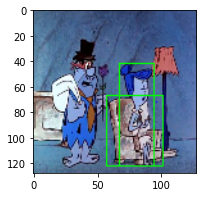

96 72
96 72 96 72


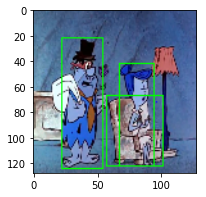

In [5]:
#cv2.imwrite('../img.jpg', cv2.cvtColor(segmented[0],cv2.COLOR_RGB2BGR))
#cv2.imwrite('../img_vid.jpg', cv2.cvtColor(video[:,:,0:3],cv2.COLOR_RGB2BGR))
import cv2
import numpy as np
from numpy import unravel_index
FPS = 25
secs = 3
frameNo = 0
plt.rcParams['figure.figsize'] = [3,3]
writer = cv2.VideoWriter('layouttestvideo.avi', cv2.VideoWriter_fourcc(*'PIM1'), FPS, (128,128), True)
for i in range(75):
    frame = video[i,:,:,:].astype('uint8')
    for e in range(mus.shape[0]):
        Ploc = Plocs[e]
        mu = mus[e]
        track = Trackings[e]
        x0, y0 = unravel_index(Ploc[:,:,i//10].argmax(), Ploc[:,:,i//10].shape)
        print(x0, y0)
        x1 = int(x0)
        y1 = int(y0)
        x2 = int(x0 +  128*(mu[frameNo]))
        y2 = int(y0 +  128*(mu[frameNo+1]))
        print(x1, y1, x2, y2)
        frame = cv2.rectangle(frame, (x1, y1), (x2, y2), (255, 0, 0), 1)
        frame = cv2.rectangle(frame, (int(track[i][0]), int(track[i][1])), (int(track[i][2]), int(track[i][3])), (0, 255, 0), 1)

        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB), cmap = 'gray', interpolation = 'bilinear')
        plt.show()
    if i%10 == 0 and i!=0: 
        frameNo = frameNo + 2
    image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    
    writer.write(image)
writer.release()

In [6]:
#!wget http://downloads.cs.stanford.edu/nlp/data/wordvecs/glove.840B.300d.zip